# Bài tập thực hành môn Phân tích và xử lý ảnh 06
# MSSV: 18110014, Họ tên: Nguyễn Phú Thành

In [1]:
import numpy as np
from matplotlib import pyplot as plt
import cv2
from skimage.measure import label as skimageLabel, regionprops
from skimage.segmentation import mark_boundaries
from skimage.morphology import erosion, dilation, opening, closing, white_tophat, disk
from skimage.transform import rescale, resize
from skimage.filters import threshold_otsu

In [2]:
def imShows(Images, Labels = None, rows = 1, cols = 1):
    imagesArray = list(Images)
    labelsArray = [f"Image {i + 1}" for i in range(len(imagesArray))] if Labels is None else list(Labels)
    figsize = (20, 20) if ((rows == 1) and (cols == 1)) else (cols * 8, rows * 5)
    fig = plt.figure(figsize = figsize)
    for i in range(1, rows * cols + 1):
        ax = fig.add_subplot(rows, cols, i)
        image = imagesArray[i - 1]
        cmap = plt.cm.gray if (len(image.shape) < 3) else None
        ax.imshow(image, cmap = cmap)
        ax.set(title = labelsArray[i - 1], xticks = [], yticks = [])
    plt.show()
def showThreeImages(IM1, IM2, IM3):
    imShows([IM1, IM2, IM3], rows = 1, cols = 3)
def showTwoImages(IM1, IM2):
    imShows([IM1, IM2], rows = 1, cols = 2)
def showOneImage(IM1):
    imShows([IM1])
def showListImages(listImage, listLabels = None, rows = 1, cols = 1):
    imShows(listImage, Labels = listLabels, rows = rows, cols = cols)

In [3]:
import os

def fromDirectory(path, extension = None):
    currentDir = os.curdir
    os.chdir(path)
    imageDict = dict()
    for file in os.listdir():
        if extension is None:
            imageDict[file] = cv2.imread(file)
        else:
            if file.endswith(extension):
                imageDict[file] = cv2.imread(file)
    os.chdir(currentDir)
    return imageDict

In [4]:
def morphology(Mask, Size):
    selem = disk(abs(Size))
    if(Size > 0):
        result = dilation(Mask, selem)
    else:
        result = erosion(Mask, selem)
    return result

In [5]:
def SegmentColorImageByMask(IM, Mask):
    Mask = Mask.astype(np.uint8)
    result = cv2.bitwise_and(IM, IM, mask = Mask)
    return result

In [6]:
def ResizeImage(IM, DesiredWidth, DesiredHeight):
    OrigWidth = float(IM.shape[1])
    OrigHeight = float(IM.shape[0])
    Width = DesiredWidth
    Height = DesiredHeight
    if((Width == 0) & (Height == 0)):
        return IM
    if(Width == 0):
        Width = int((OrigWidth * Height)/OrigHeight)
    if(Height == 0):
        Height = int((OrigHeight * Width)/OrigWidth)
    dim = (Width, Height)
    resizedIM = cv2.resize(IM, dim, interpolation = cv2.INTER_NEAREST)
    return resizedIM

In [7]:
def SegmentByKmeans(image_orig, nClusters = 3):
    img = image_orig.copy()
    Z = img.reshape((-1,3))
    # Convert to np.float32
    Z = np.float32(Z)
    # Define criteria, number of clusters(K) and apply kmeans()
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 1.0)
    K = nClusters
    ret,labellist,center = cv2.kmeans(Z,K,None,criteria,10,cv2.KMEANS_RANDOM_CENTERS)
    # Now convert back into uint8, and make original image
    center = np.uint8(center)
    res = center[labellist.flatten()]
    res2 = res.reshape((img.shape))
    label2 = labellist.reshape((img.shape[:2]))
    image_index = label2
    image_kmeans = res2
    # Sort to make sure the index is stable
    AreaList = []
    for idx in range(image_index.max() + 1):
        mask = image_index == idx
        AreaList.append(mask.sum().sum())
    
    sort_index = np.argsort(AreaList)[::-1]
    index = 0
    image_index1 = image_index * 0
    
    for idx in sort_index:
        image_index1[image_index == idx] = index
        index = index + 1
    image_index = image_index1.copy()
    return image_index, image_kmeans

In [8]:
def LabelObjectByMask(image_input, image_mask, kind = "BBox", color = (0,255,0), thick = 2):
    image_input = image_orig.copy()
    image_output = image_input.copy()
    label_img = skimageLabel(image_mask)
    regions = regionprops(label_img)
    
    for props in regions:
        minr, minc, maxr, maxc = props.bbox
        left_top = (minc, minr)
        right_bottom = (maxc, maxr)
        at_row, at_col = props.centroid
        if(kind == "Center"):
            cv2.drawMarker(image_output, (int(at_col), int(at_row)),
                           color, markerType = cv2.MARKER_STAR,
                           markerSize = 15, thickness = thick, line_type = cv2.LINE_AA)
        if(kind == "BBox"):
            cv2.rectangle(image_output,left_top, right_bottom, color ,thick)
    
    if(kind == "Boundary"):
        color = [(number / 255) for number in color]
        image_mask = morphology(image_mask, 1)
        image_output = mark_boundaries(image_output, image_mask, color = color, mode='thick')
    if(kind == "Fill"):
        image_output[image_mask > 0] = color
    return image_output

In [9]:
def SelectMaskByThreshArea(Mask, minArea = 300, maxArea = 100000):
    mask = Mask.copy()
    mask_output = mask * 0
    bboxList = []
    label_img = skimageLabel(mask)
    regions = regionprops(label_img)
    for props in regions:
        area = props.area
        label = props.label
        if((area > minArea) and (area < maxArea)):
            mask_output = mask_output + (label_img == label).astype(int)
    return mask_output

In [10]:
def showOutput(origImg, mask, color = (0, 255, 0), thick = 2):
    output = [origImg,]
    for kind in ['Fill', 'BBox', 'Center', 'Boundary']:
        output.append(LabelObjectByMask(origImg, mask, kind = kind, color = color, thick = thick))
    return output

In [11]:
imageDict = fromDirectory(r'Lab06 - Image/')

# Thực hiện segmentation tất cả các đối tượng sau từ tập thư mục ảnh (tùy chọn 1 trong 5 ảnh mỗi loại)

# * Vết Defect A

In [12]:
defectA =  imageDict['DefectA 01.bmp']

image_orig = cv2.cvtColor(defectA, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(defectA, cv2.COLOR_BGR2GRAY)
image_hsv = cv2.cvtColor(defectA, cv2.COLOR_BGR2HSV)
image_ycbr = cv2.cvtColor(defectA, cv2.COLOR_BGR2YCR_CB)

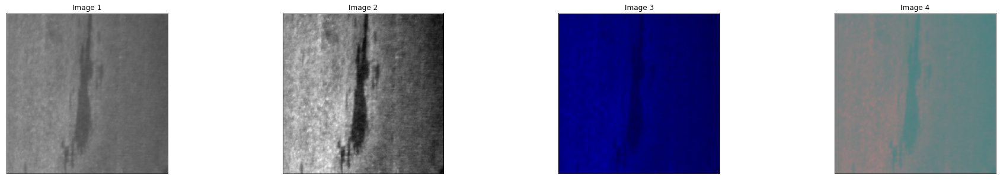

In [13]:
showListImages([image_orig, image_gray, image_hsv, image_ycbr], rows = 1, cols = 4)

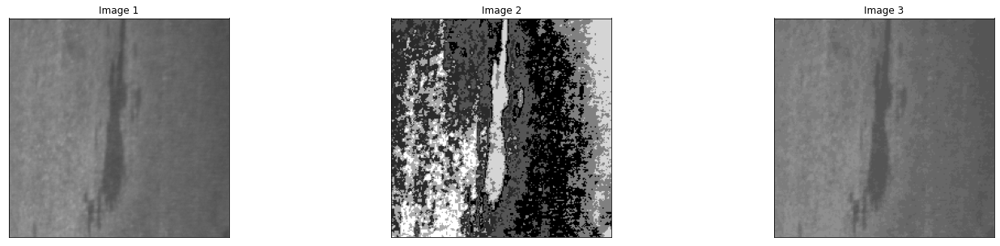

In [14]:
image_index, image_kmeans = SegmentByKmeans(image_orig, nClusters = 7)
showListImages([image_orig, image_index, image_kmeans], rows = 1, cols = 3)

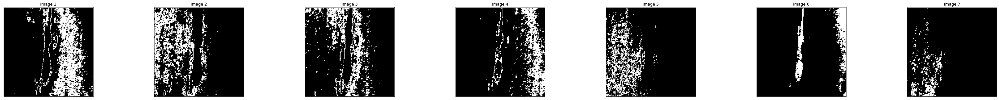

In [15]:
mask_list = []
mask_abnormal = image_gray * 0

for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 400, maxArea = 2000)
    mask_list.append(imask)
    mask_abnormal = mask_abnormal + mask_small

showListImages(mask_list, rows = 1, cols = len(mask_list))

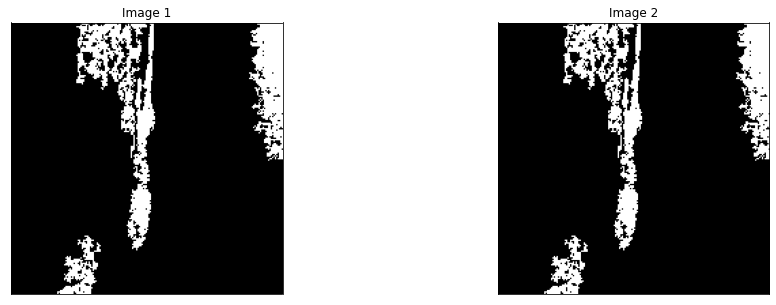

In [16]:
showListImages([mask_abnormal] * 2, rows = 1, cols = 2)

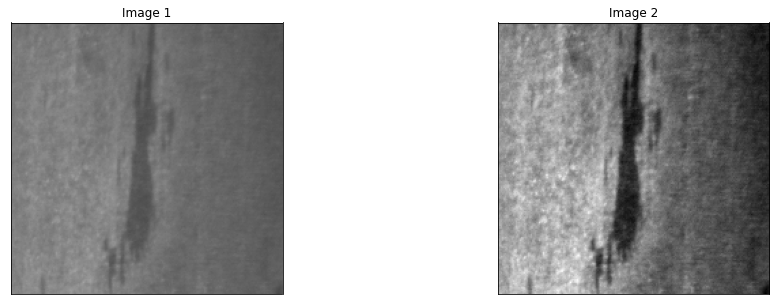

In [17]:
label_img = skimageLabel(mask_abnormal)
regions = regionprops(label_img, intensity_image = image_gray)
mask_condition = mask_abnormal * 0
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    condition = (area > 1300) and (area < 1400)
    if(condition):
        mask_condition += (imask).astype(int)
showListImages([image_orig, image_gray], rows = 1, cols = 2)

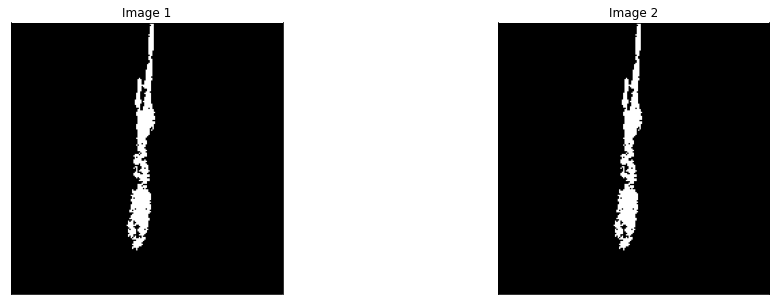

In [18]:
showListImages([mask_condition] * 2, rows = 1, cols = 2)

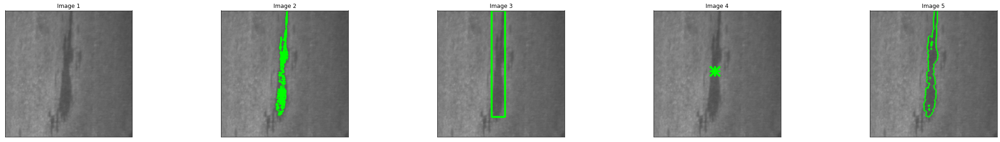

In [19]:
outputList = showOutput(image_orig, mask_condition)

showListImages(outputList, rows = 1, cols = len(outputList))

# * Vết defect B

In [20]:
defectB =  imageDict['DefectB 01.bmp']

image_orig = cv2.cvtColor(defectB, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(defectB, cv2.COLOR_BGR2GRAY)
image_hsv = cv2.cvtColor(defectB, cv2.COLOR_BGR2HSV)
image_ycbr = cv2.cvtColor(defectB, cv2.COLOR_BGR2YCR_CB)

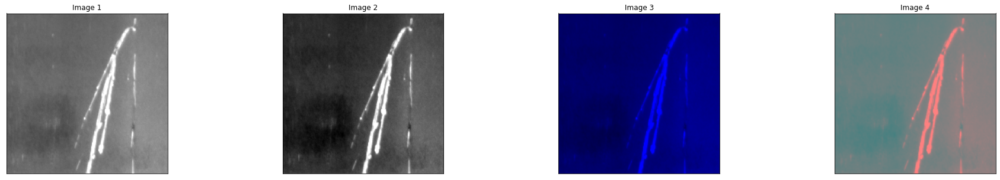

In [21]:
showListImages([image_orig, image_gray, image_hsv, image_ycbr], rows = 1, cols = 4)

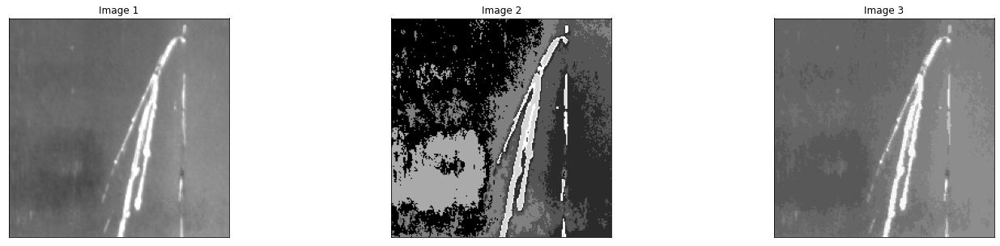

In [22]:
image_index, image_kmeans = SegmentByKmeans(image_orig, nClusters = 7)
showListImages([image_orig, image_index, image_kmeans], rows = 1, cols = 3)

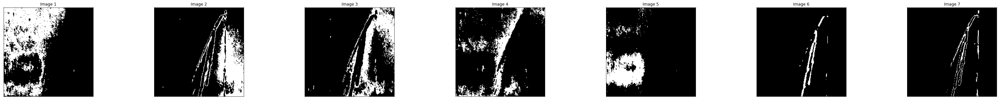

In [23]:
mask_list = []
mask_abnormal = image_gray * 0

for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 100, maxArea = 2000)
    mask_list.append(imask)
    mask_abnormal = mask_abnormal + mask_small

showListImages(mask_list, rows = 1, cols = len(mask_list))

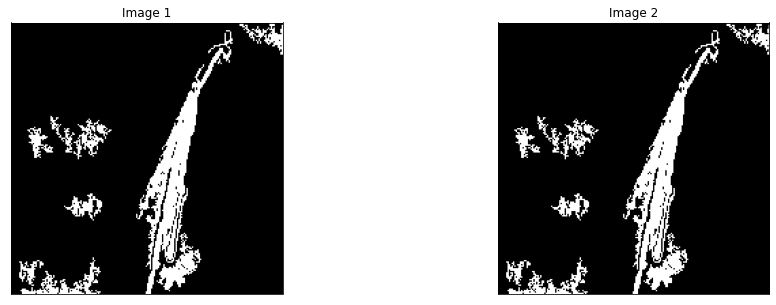

In [24]:
showListImages([mask_abnormal] * 2, rows = 1, cols = 2)

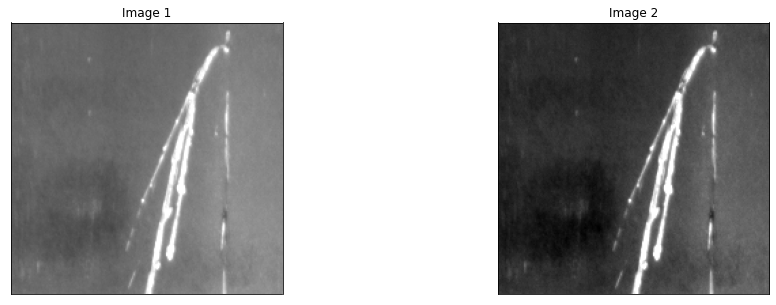

In [25]:
label_img = skimageLabel(mask_abnormal)
regions = regionprops(label_img, intensity_image = image_gray)
mask_condition = mask_abnormal * 0
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    condition = (area > 2000)
    if(condition):
        mask_condition += (imask).astype(int)
showListImages([image_orig, image_gray], rows = 1, cols = 2)

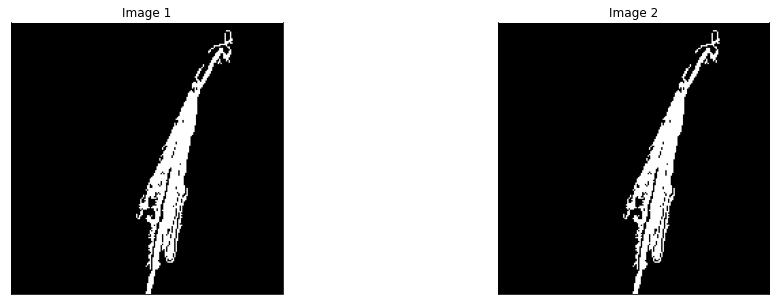

In [26]:
showListImages([mask_condition] * 2, rows = 1, cols = 2)

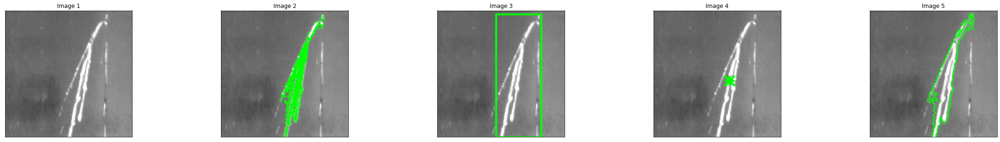

In [27]:
outputList = showOutput(image_orig, mask_condition)
showListImages(outputList, rows = 1, cols = len(outputList))

# * Biển số xe

In [28]:
licensePlate = imageDict['DrivingPlate 01.jpg']

image_orig = cv2.cvtColor(licensePlate, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(licensePlate, cv2.COLOR_BGR2GRAY)
image_hsv = cv2.cvtColor(licensePlate, cv2.COLOR_BGR2HSV)
image_ycbr = cv2.cvtColor(licensePlate, cv2.COLOR_BGR2YCR_CB)

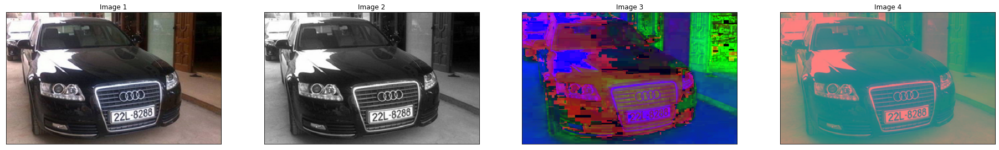

In [29]:
showListImages([image_orig, image_gray, image_hsv, image_ycbr], rows = 1, cols = 4)

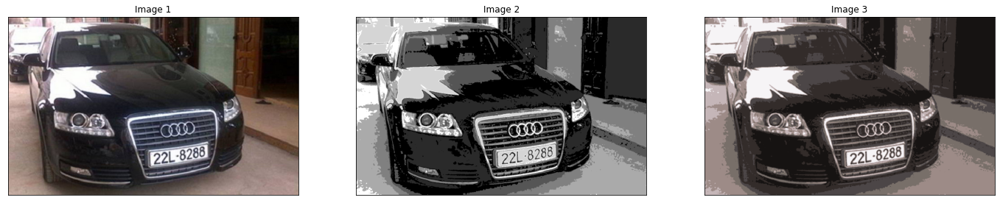

In [30]:
image_index, image_kmeans = SegmentByKmeans(image_orig, nClusters = 7)
showListImages([image_orig, image_index, image_kmeans], rows = 1, cols = 3)

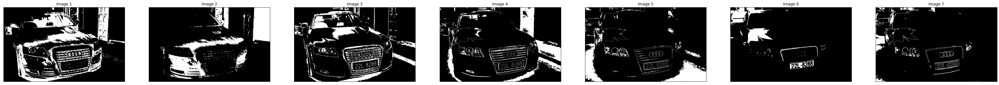

In [31]:
mask_list = []
mask_abnormal = image_gray * 0

for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 0, maxArea = 8000)
    mask_list.append(imask)
    mask_abnormal = mask_abnormal + mask_small

showListImages(mask_list, rows = 1, cols = len(mask_list))

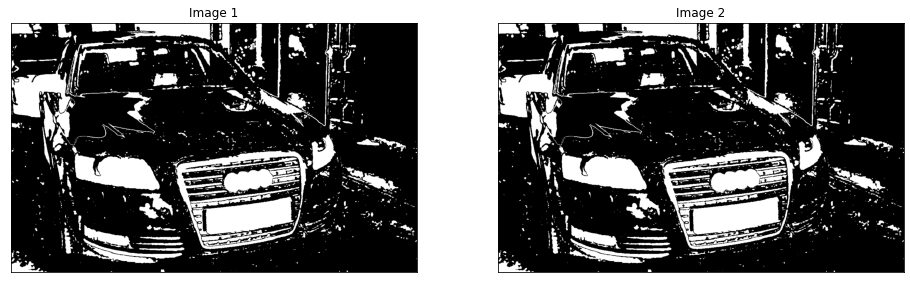

In [32]:
showListImages([mask_abnormal] * 2, rows = 1, cols = 2)

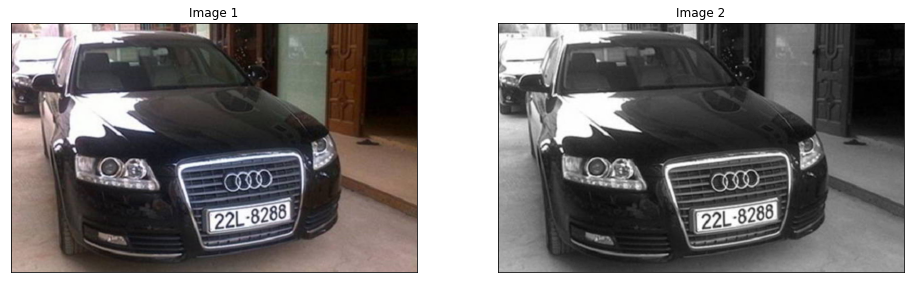

In [33]:
label_img = skimageLabel(mask_abnormal)
regions = regionprops(label_img, intensity_image = image_gray)
mask_condition = mask_abnormal * 0
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    condition = (area > 20000) and (area < 25000) and (imean > 150)
    if(condition):
        mask_condition += (imask).astype(int)
showListImages([image_orig, image_gray], rows = 1, cols = 2)

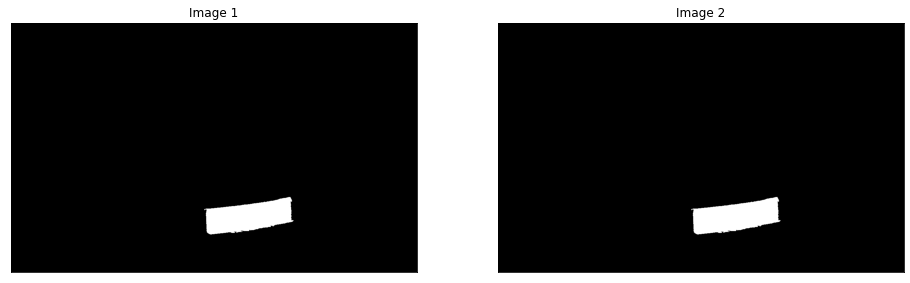

In [34]:
showListImages([mask_condition] * 2, rows = 1, cols = 2)

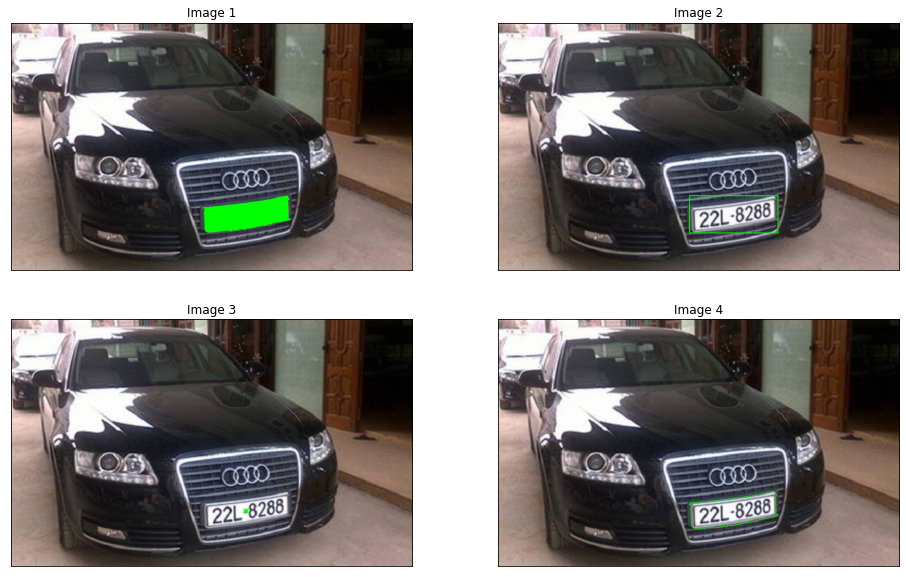

In [35]:
outputList = showOutput(image_orig, mask_condition)
showListImages(outputList[1:], rows = 2, cols = 2)

# * Vết xuất huyết và xuất tiết

In [36]:
eye = imageDict['Eye 04.jpg']

image_orig = cv2.cvtColor(eye, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(eye, cv2.COLOR_BGR2GRAY)
image_hsv = cv2.cvtColor(eye, cv2.COLOR_BGR2HSV)
image_ycbr = cv2.cvtColor(eye, cv2.COLOR_BGR2YCR_CB)

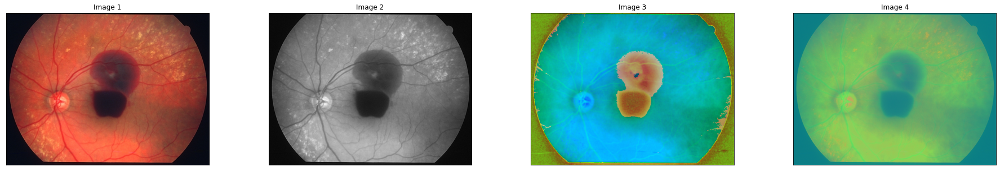

In [37]:
showListImages([image_orig, image_gray, image_hsv, image_ycbr], rows = 1, cols = 4)

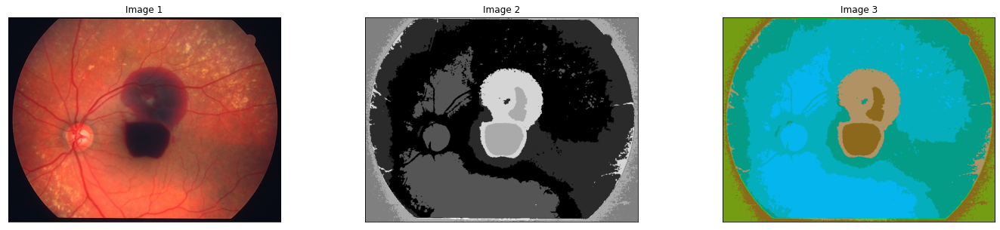

In [38]:
image_index, image_kmeans = SegmentByKmeans(image_hsv, nClusters = 7)
showListImages([image_orig, image_index, image_kmeans], rows = 1, cols = 3)

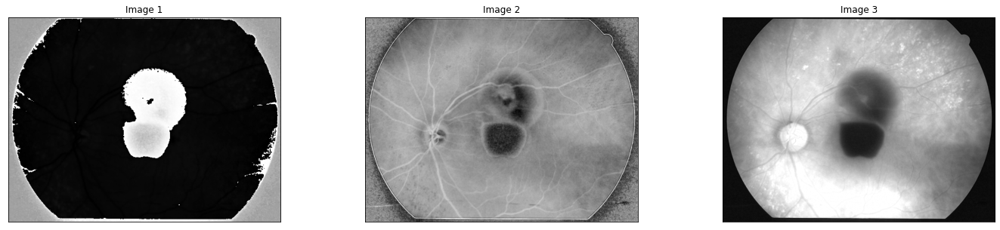

In [39]:
showListImages([image_hsv[:, :, 0], image_hsv[:, :, 1], image_hsv[:, :, 2]], rows = 1, cols = 3)

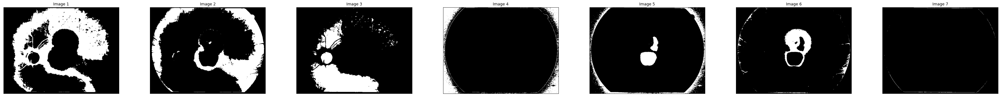

In [40]:
mask_list = []
mask_abnormal = image_gray * 0

for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 2000, maxArea = 16000)
    mask_list.append(imask)
    mask_abnormal = mask_abnormal + mask_small

showListImages(mask_list, rows = 1, cols = len(mask_list))

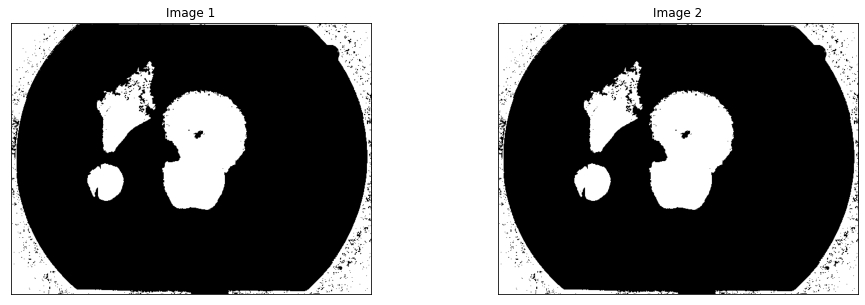

In [41]:
showListImages([mask_abnormal] * 2, rows = 1, cols = 2)

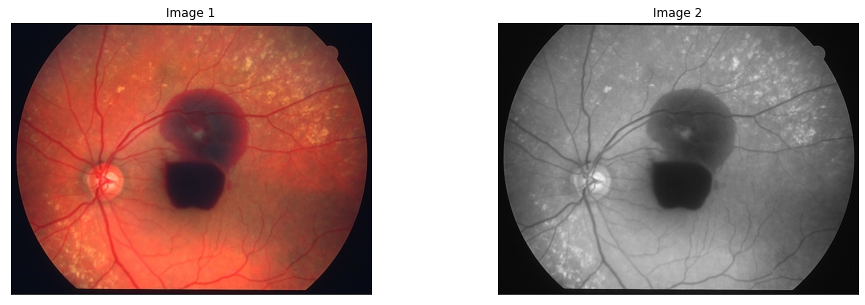

In [42]:
label_img = skimageLabel(mask_abnormal)
regions = regionprops(label_img, intensity_image = image_hsv[:, :, 0])
mask_condition1 = mask_abnormal * 0
mask_condition2 = mask_abnormal * 0
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imax = props.max_intensity
    imin = props.min_intensity
    
    condition1 = (area > 23000) and (area < 40000)
    condition2 = (area < 4000)
    if(condition1):
        mask_condition1 += (imask).astype(int)
    if(condition2):
        mask_condition2 += (imask).astype(int)
showListImages([image_orig, image_gray], rows = 1, cols = 2)

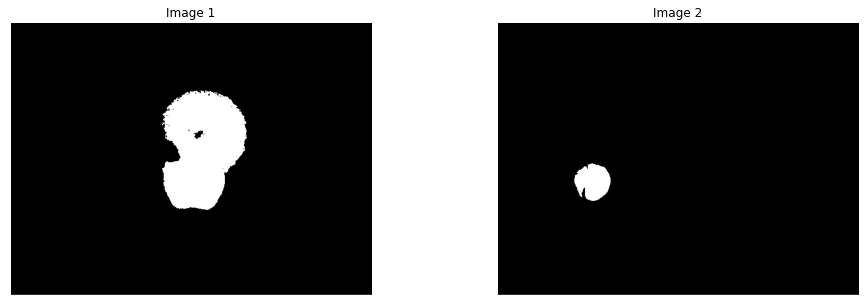

In [43]:
showListImages([mask_condition1, mask_condition2], rows = 1, cols = 2)

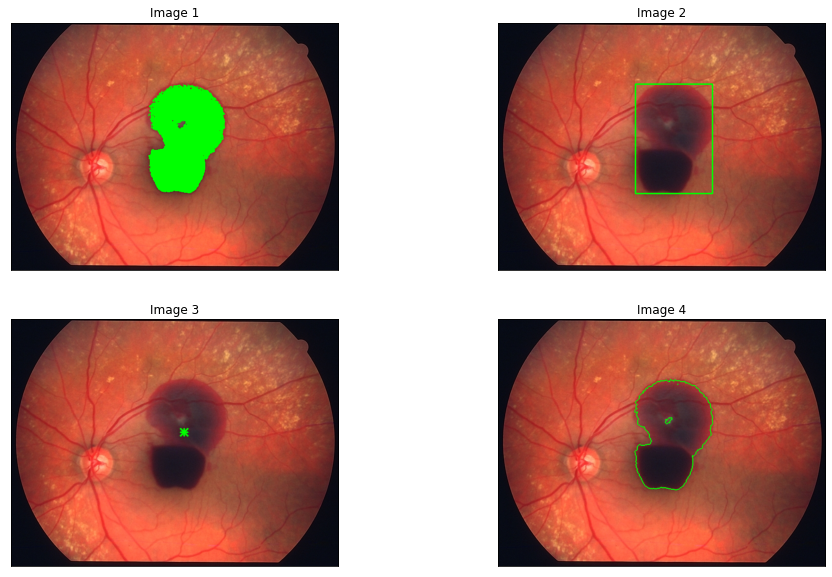

In [44]:
outputList = showOutput(image_orig, mask_condition1)
showListImages(outputList[1:], rows = 2, cols = 2)

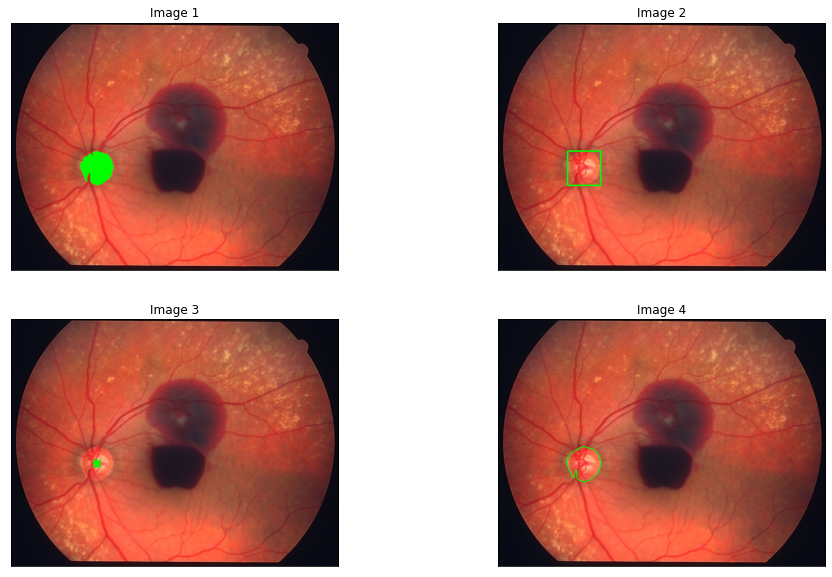

In [45]:
outputList = showOutput(image_orig, mask_condition2)
showListImages(outputList[1:], rows = 2, cols = 2)

# * Khuôn mặt người

In [46]:
faces = imageDict['Face 02.jpg']

image_orig = cv2.cvtColor(faces, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(faces, cv2.COLOR_BGR2GRAY)
image_hsv = cv2.cvtColor(faces, cv2.COLOR_BGR2HSV)
image_ycbr = cv2.cvtColor(faces, cv2.COLOR_BGR2YCR_CB)

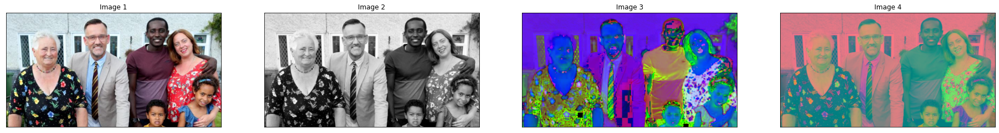

In [47]:
showListImages([image_orig, image_gray, image_hsv, image_ycbr], rows = 1, cols = 4)

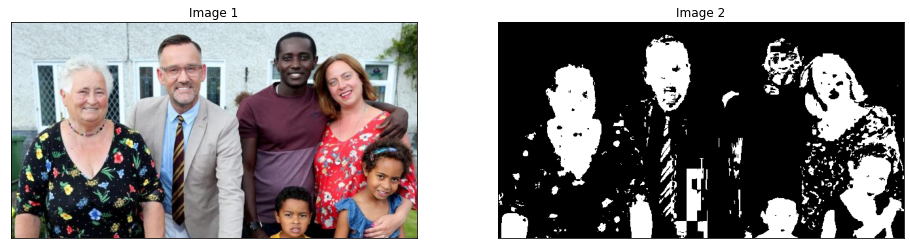

In [48]:
lower = np.array([0, 0, 50], dtype = "uint8")
upper = np.array([30, 255, 255], dtype = "uint8")
skinMask = cv2.inRange(image_hsv, lower, upper)
showListImages([image_orig, skinMask], rows = 1, cols = 2)

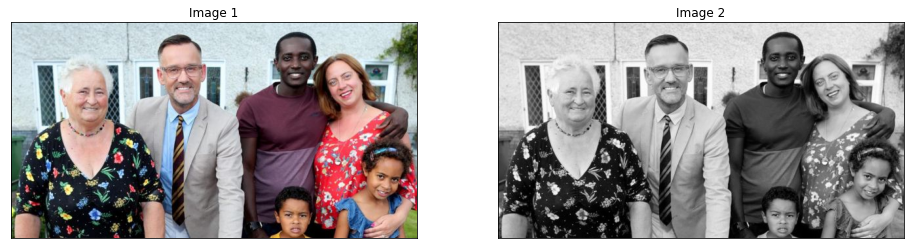

In [49]:
label_img = skimageLabel(skinMask)
regions = regionprops(label_img, intensity_image = image_hsv[:, :, 0])
mask_condition = skinMask * 0
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    
    condition1 = (1400 < area < 1800)
    condition2 = (area > 2000)
    if(condition1) or (condition2):
        mask_condition = mask_condition + (imask).astype(int)

showListImages([image_orig, image_gray], rows = 1, cols = 2)

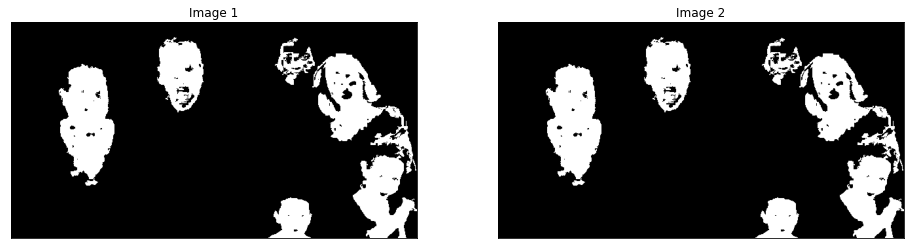

In [50]:
showListImages([mask_condition] * 2, rows = 1, cols = 2)

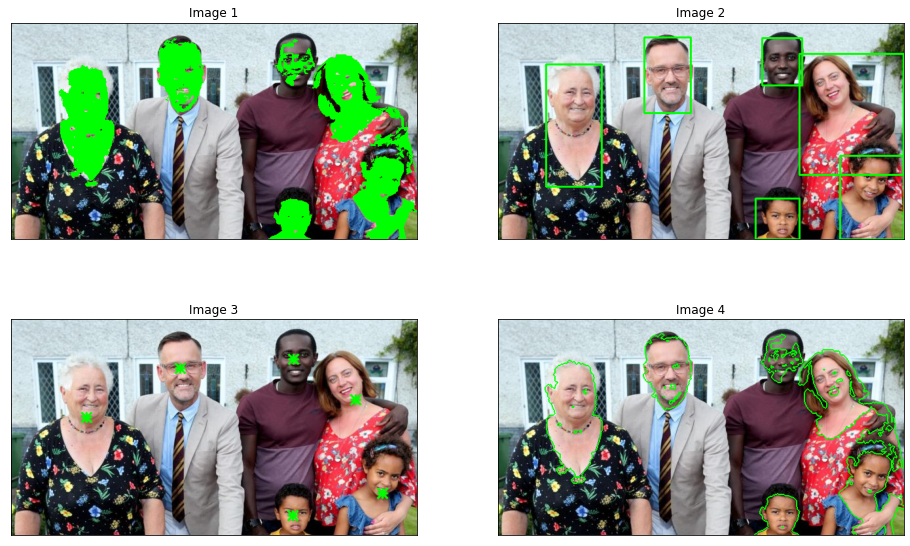

In [51]:
outputList = showOutput(image_orig, mask_condition)
showListImages(outputList[1:], rows = 2, cols = 2)

# * Lửa

In [52]:
fire = imageDict['Fire 01.jpg']

image_orig = cv2.cvtColor(fire, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(fire, cv2.COLOR_BGR2GRAY)
image_hsv = cv2.cvtColor(fire, cv2.COLOR_BGR2HSV)
image_ycbr = cv2.cvtColor(fire, cv2.COLOR_BGR2YCR_CB)

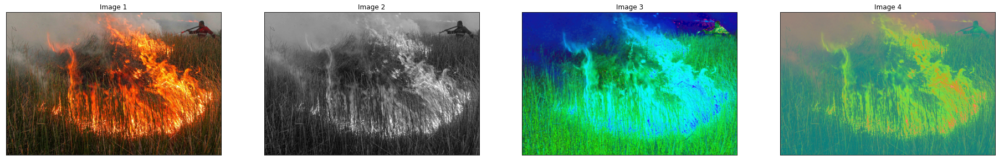

In [53]:
showListImages([image_orig, image_gray, image_hsv, image_ycbr], rows = 1, cols = 4)

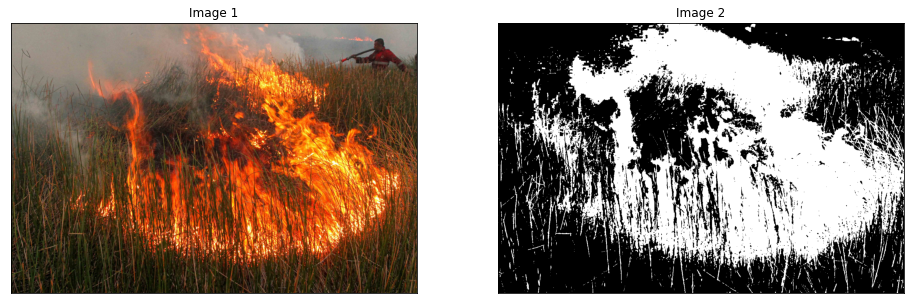

In [54]:
lower = np.array([0, 50, 100], dtype = "uint8")
upper = np.array([100, 255, 255], dtype = "uint8")
fireMask = cv2.inRange(image_hsv, lower, upper)
showListImages([image_orig, fireMask], rows = 1, cols = 2)

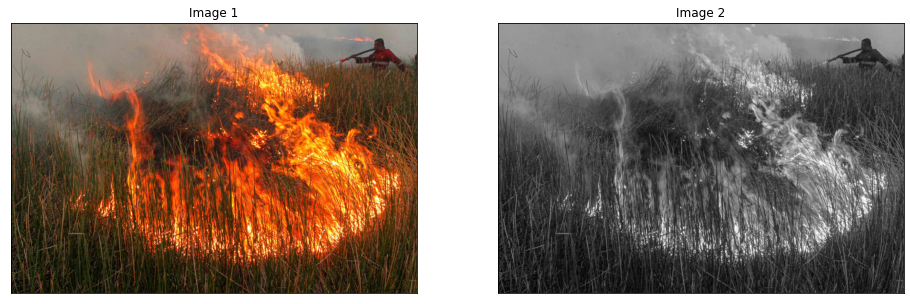

In [55]:
label_img = skimageLabel(fireMask)
regions = regionprops(label_img, intensity_image = image_hsv[:, :, 0])
mask_condition = fireMask * 0
for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    imin = props.min_intensity
    imax = props.max_intensity
    
    condition = area > 20000
    if(condition):
        mask_condition = mask_condition + (imask).astype(int)

showListImages([image_orig, image_gray], rows = 1, cols = 2)

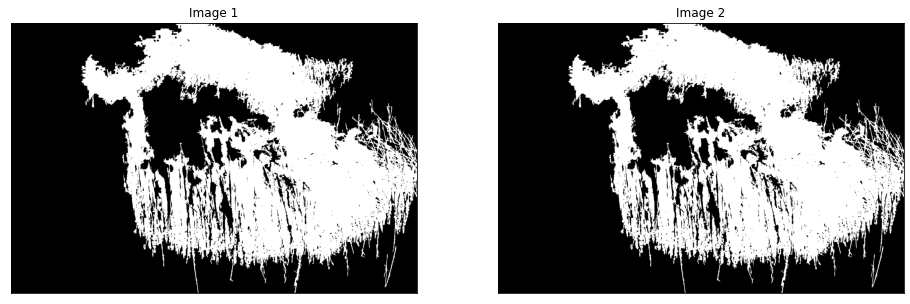

In [56]:
showListImages([mask_condition] * 2, rows = 1, cols = 2)

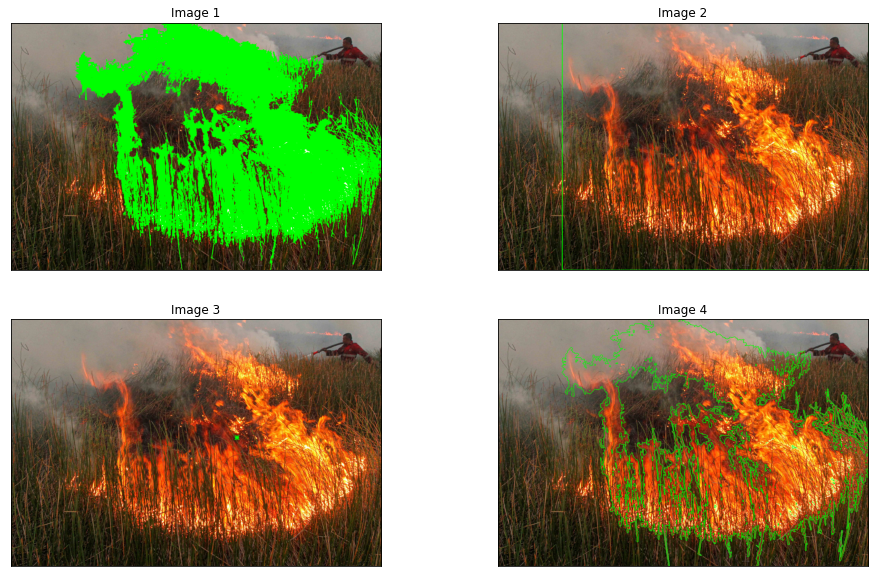

In [57]:
outputList = showOutput(image_orig, mask_condition)
showListImages(outputList[1:], rows = 2, cols = 2)

# * Bông hoa

In [58]:
flowers =  imageDict['Flower 01.jpg']
image_orig = cv2.cvtColor(flowers, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(flowers, cv2.COLOR_BGR2GRAY)
image_hsv = cv2.cvtColor(flowers, cv2.COLOR_BGR2HSV)
image_ycbr = cv2.cvtColor(flowers, cv2.COLOR_BGR2YCR_CB)

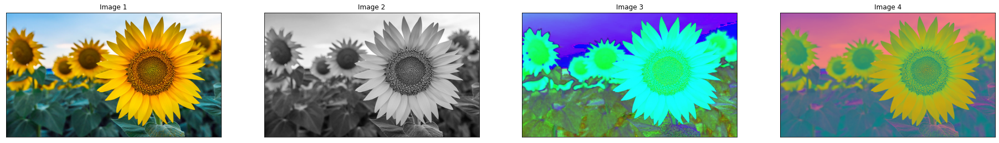

In [59]:
showListImages([image_orig, image_gray, image_hsv, image_ycbr], rows = 1, cols = 4)

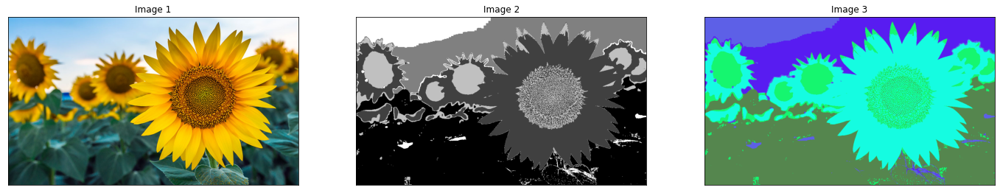

In [60]:
image_index, image_kmeans = SegmentByKmeans(image_hsv, nClusters = 5)
showListImages([image_orig, image_index, image_kmeans], rows = 1, cols = 3)

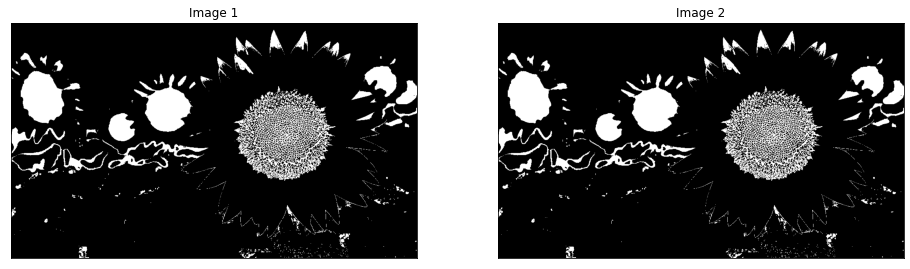

In [61]:
mask_list = []
mask_abnormal = image_gray * 0

for idx in [3]:
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 1700, maxArea = 23000)
    mask_list.append(imask)
    mask_abnormal = mask_abnormal + mask_small

showListImages(mask_list * 2, rows = 1, cols = 2)

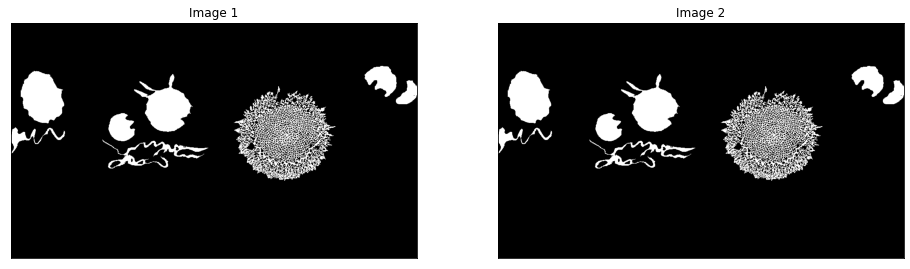

In [62]:
showListImages([mask_abnormal] * 2, rows = 1, cols = 2)

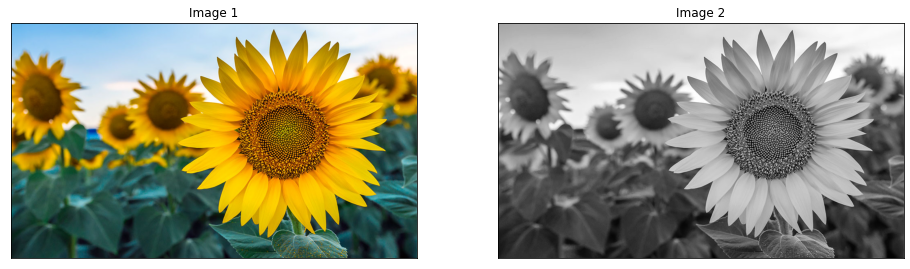

In [63]:
label_img = skimageLabel(mask_abnormal)
regions = regionprops(label_img, intensity_image = image_hsv[:, :, 0])
mask_condition = mask_abnormal * 0

for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    imean = props.mean_intensity
    
    condition1 = (area < 1800)
    condition2 = (area > 3000) and (imean < 25)
    if condition1 or condition2:
        mask_condition += imask.astype(int)
showListImages([image_orig, image_gray], rows = 1, cols = 2)

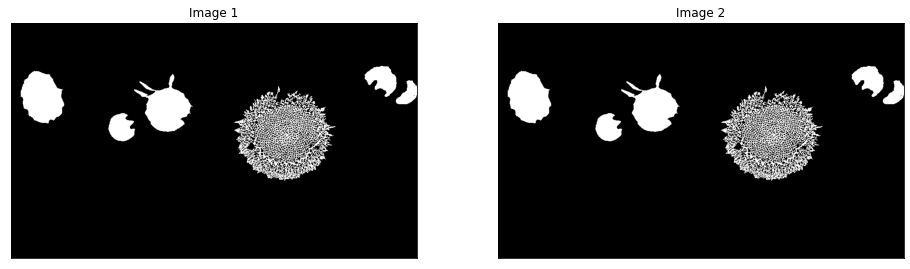

In [64]:
showListImages([mask_condition] * 2, rows = 1, cols = 2)

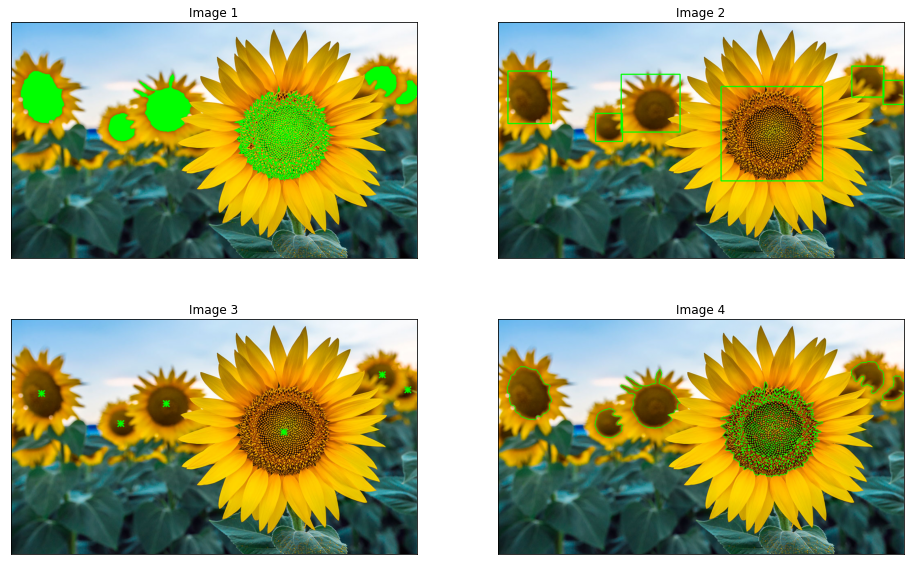

In [65]:
outputList = showOutput(image_orig, mask_condition)
showListImages(outputList[1:], rows = 2, cols = 2)

# * Trái bóng

In [66]:
ball =  imageDict['Football 01.jpg']
image_orig = cv2.cvtColor(ball, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(ball, cv2.COLOR_BGR2GRAY)
image_hsv = cv2.cvtColor(ball, cv2.COLOR_BGR2HSV)
image_ycbr = cv2.cvtColor(ball, cv2.COLOR_BGR2YCR_CB)

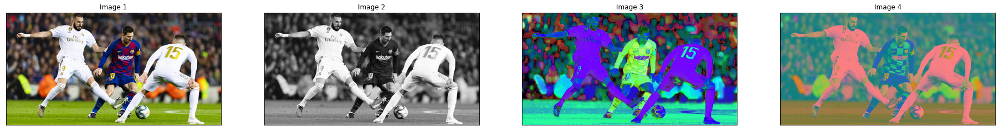

In [67]:
showListImages([image_orig, image_gray, image_hsv, image_ycbr], rows = 1, cols = 4)

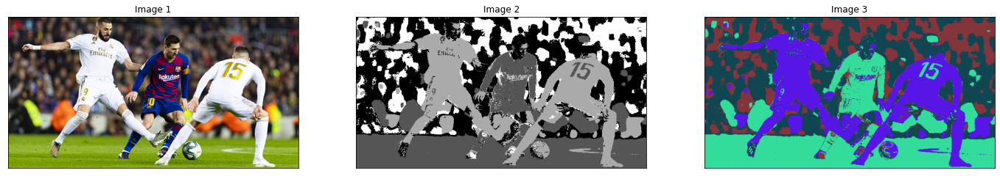

In [68]:
image_index, image_kmeans = SegmentByKmeans(image_hsv, nClusters = 4)
showListImages([image_orig, image_index, image_kmeans], rows = 1, cols = 3)

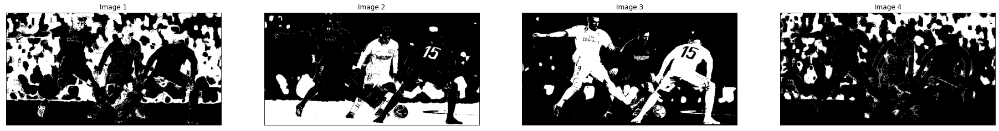

In [69]:
mask_list = []
mask_abnormal = image_gray * 0

for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 800, maxArea = 1000)
    mask_list.append(imask)
    mask_abnormal = mask_abnormal + mask_small

showListImages(mask_list, rows = 1, cols = len(mask_list))

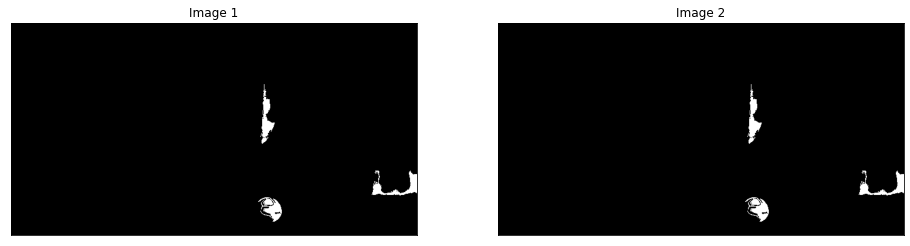

In [70]:
showListImages([mask_abnormal] * 2, rows = 1, cols = 2)

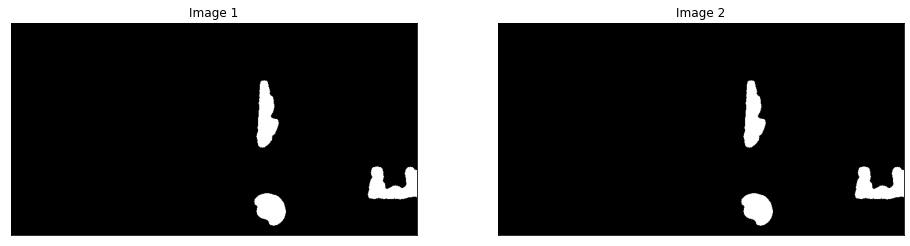

In [71]:
mask_abnormal = morphology(morphology(mask_abnormal, 10), -3)
showListImages([mask_abnormal] * 2, rows = 1, cols = 2)

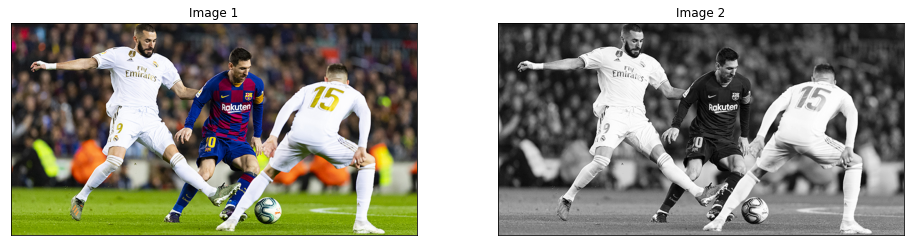

In [72]:
label_img = skimageLabel(mask_abnormal)
regions = regionprops(label_img, intensity_image = image_hsv[:, :, 0])
mask_condition = mask_abnormal * 0

for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    
    condition = (area < 2500)
    if condition:
        mask_condition += imask.astype(int)
showListImages([image_orig, image_gray], rows = 1, cols = 2)

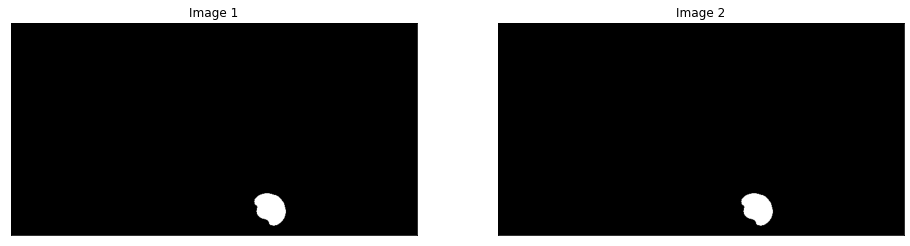

In [73]:
showListImages([mask_condition] * 2, rows = 1, cols = 2)

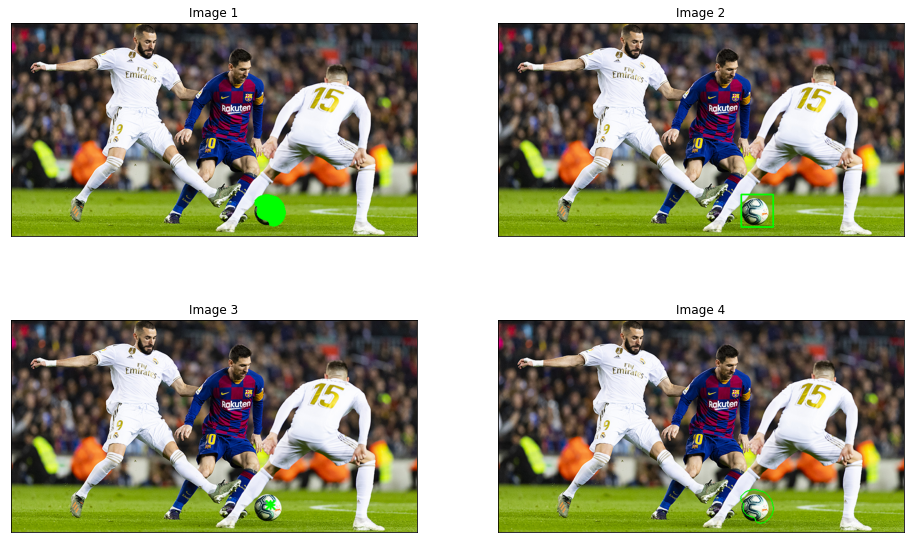

In [74]:
outputList = showOutput(image_orig, mask_condition)
showListImages(outputList[1:], rows = 2, cols = 2)

# * Bàn tay

In [75]:
hands =  imageDict['Hand Gesture 01.jpg']
image_orig = cv2.cvtColor(hands, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(hands, cv2.COLOR_BGR2GRAY)
image_hsv = cv2.cvtColor(hands, cv2.COLOR_BGR2HSV)
image_ycbr = cv2.cvtColor(hands, cv2.COLOR_BGR2YCR_CB)

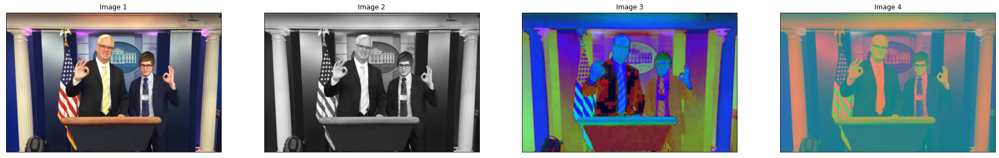

In [76]:
showListImages([image_orig, image_gray, image_hsv, image_ycbr], rows = 1, cols = 4)

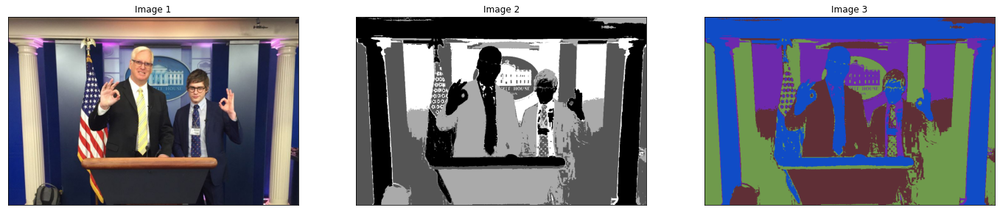

In [77]:
image_index, image_kmeans = SegmentByKmeans(image_hsv, nClusters = 4)
showListImages([image_orig, image_index, image_kmeans], rows = 1, cols = 3)

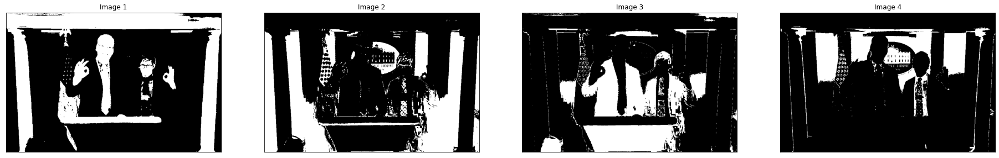

In [78]:
mask_list = []
mask_abnormal = image_gray * 0

for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 2500, maxArea = 5000)
    mask_list.append(imask)
    mask_abnormal = mask_abnormal + mask_small

showListImages(mask_list, rows = 1, cols = len(mask_list))

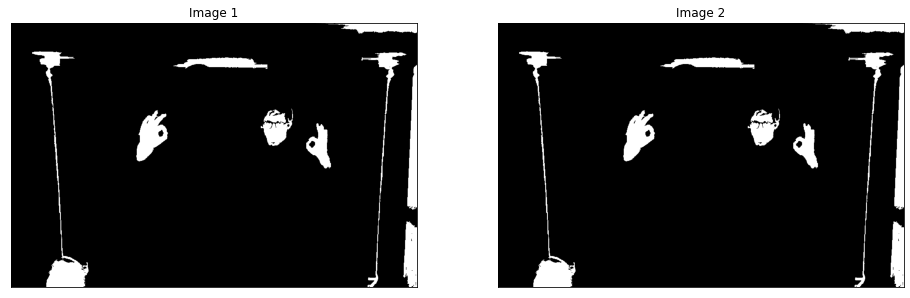

In [79]:
showListImages([mask_abnormal] * 2, rows = 1, cols = 2)

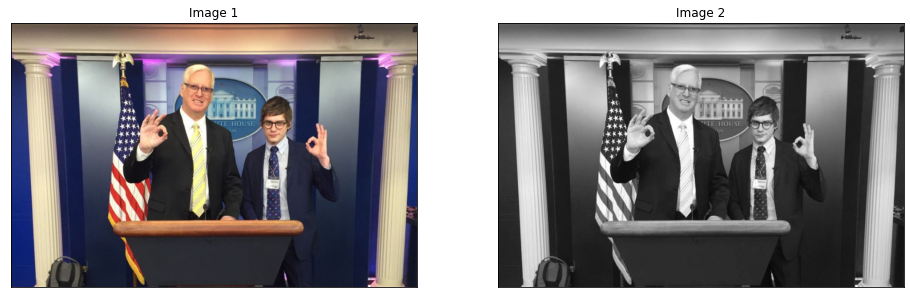

In [80]:
label_img = skimageLabel(mask_abnormal)
regions = regionprops(label_img, intensity_image = image_hsv[:, :, 0])
mask_condition = mask_abnormal * 0

for props in regions:
    area = props.area
    ilabel = props.label
    imean = props.mean_intensity
    imin = props.min_intensity
    imax = props.max_intensity
    imask = label_img == ilabel
    
    condition1 = (area < 3000) and (imean < 10)
    condition2 = (area > 4000) and (imax < 100)
    
    if (condition1 or condition2):
        mask_condition += imask.astype(int)
showListImages([image_orig, image_gray], rows = 1, cols = 2)

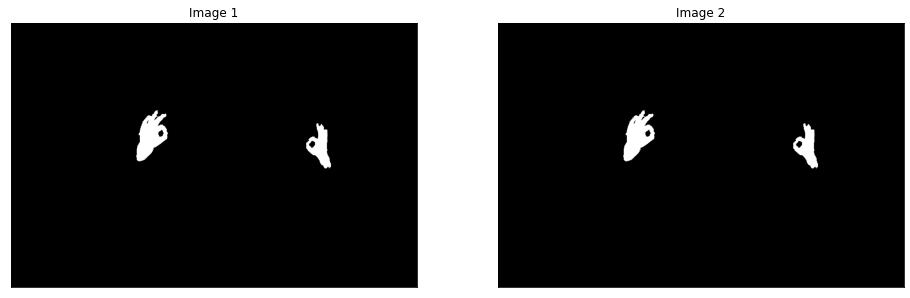

In [81]:
showListImages([mask_condition] * 2, rows = 1, cols = 2)

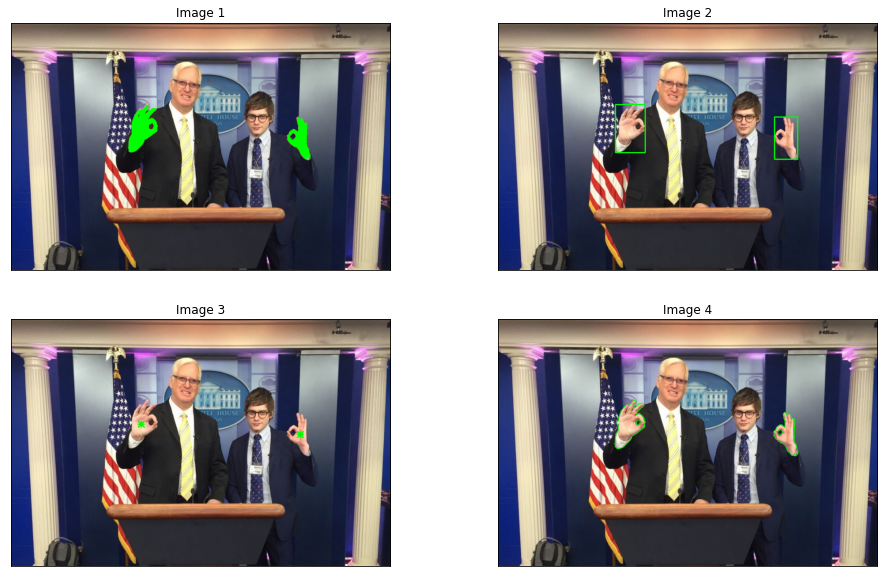

In [82]:
outputList = showOutput(image_orig, mask_condition)
showListImages(outputList[1:], rows = 2, cols = 2)

# * Võng mạc

In [83]:
iris = imageDict['Iris 03.jpg']
image_orig = cv2.cvtColor(iris, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(iris, cv2.COLOR_BGR2GRAY)
image_hsv = cv2.cvtColor(iris, cv2.COLOR_BGR2HSV)
image_ycbr = cv2.cvtColor(iris, cv2.COLOR_BGR2YCR_CB)

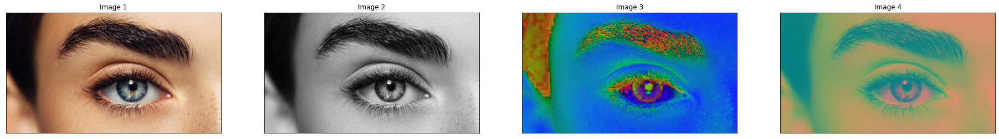

In [84]:
showListImages([image_orig, image_gray, image_hsv, image_ycbr], rows = 1, cols = 4)

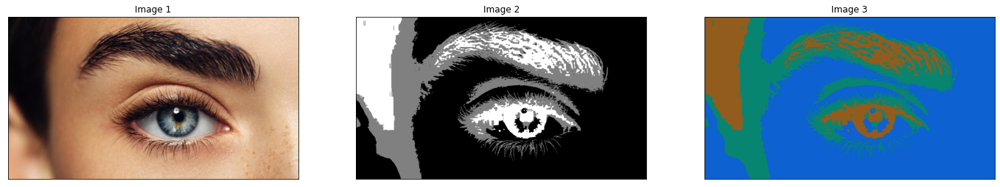

In [85]:
image_index, image_kmeans = SegmentByKmeans(image_hsv, nClusters = 3)
showListImages([image_orig, image_index, image_kmeans], rows = 1, cols = 3)

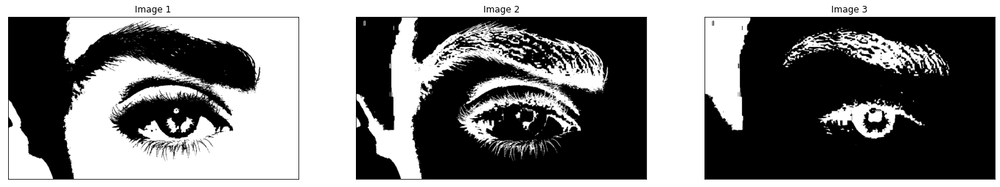

In [86]:
mask_list = []
mask_abnormal = image_gray * 0

for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 100, maxArea = 3000)
    mask_list.append(imask)
    mask_abnormal = mask_abnormal + mask_small

showListImages(mask_list, rows = 1, cols = len(mask_list))

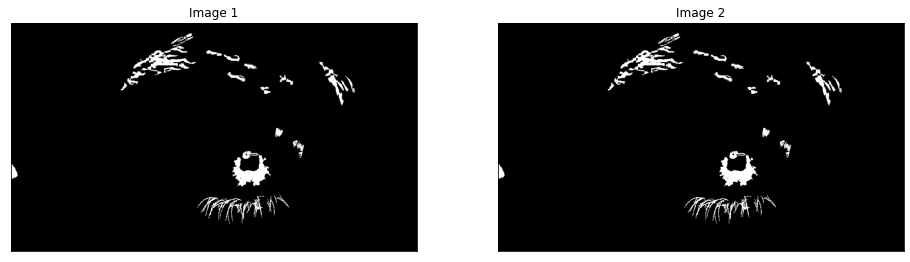

In [87]:
showListImages([mask_abnormal] * 2, rows = 1, cols = 2)

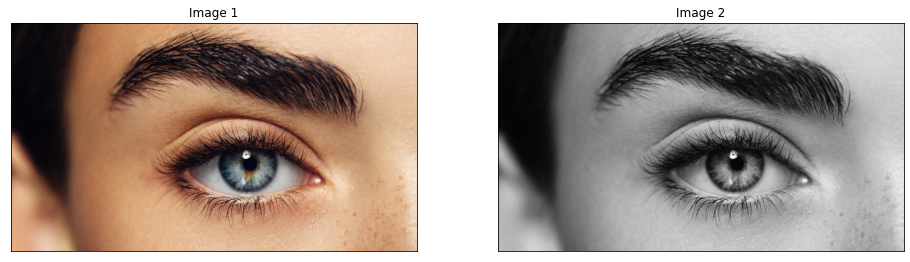

In [88]:
label_img = skimageLabel(mask_abnormal)
regions = regionprops(label_img, intensity_image = image_hsv[:, :, 0])
mask_condition = mask_abnormal * 0

for props in regions:
    area = props.area
    ilabel = props.label
    imean = props.mean_intensity
    imin = props.min_intensity
    imax = props.max_intensity
    imask = label_img == ilabel
    
    condition = (area > 3000)
    
    if condition:
        mask_condition += imask.astype(int)

showListImages([image_orig, image_gray], rows = 1, cols = 2)

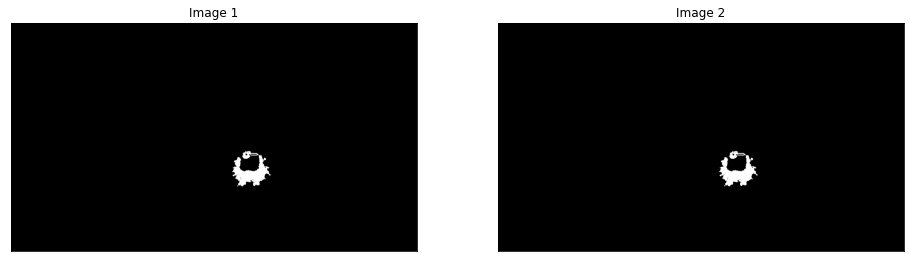

In [89]:
showListImages([mask_condition] * 2, rows = 1, cols = 2)

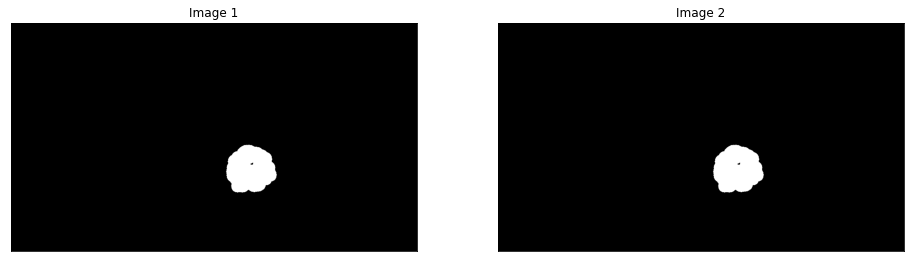

In [90]:
mask_condition = morphology(mask_condition, 15) # Fill holes
showListImages([mask_condition] * 2, rows = 1, cols = 2)

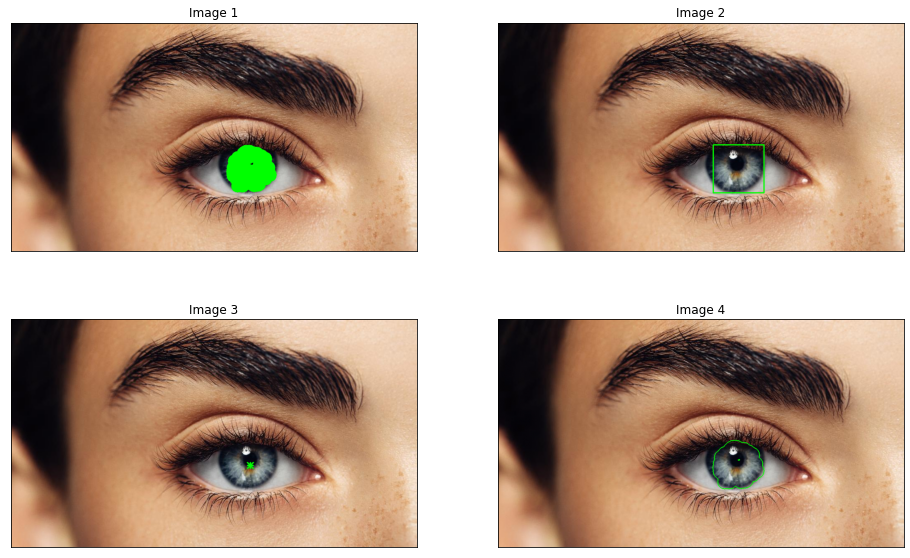

In [91]:
outputList = showOutput(image_orig, mask_condition)
showListImages(outputList[1:], rows = 2, cols = 2)

# * Lá phổi

In [92]:
lungs = imageDict['Lung 01.png']
image_orig = cv2.cvtColor(lungs, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(lungs, cv2.COLOR_BGR2GRAY)
image_hsv = cv2.cvtColor(lungs, cv2.COLOR_BGR2HSV)
image_ycbr = cv2.cvtColor(lungs, cv2.COLOR_BGR2YCR_CB)

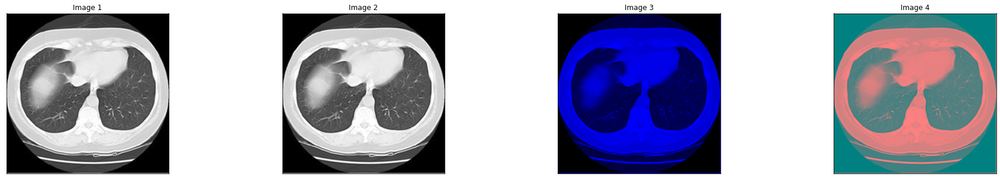

In [93]:
showListImages([image_orig, image_gray, image_hsv, image_ycbr], rows = 1, cols = 4)

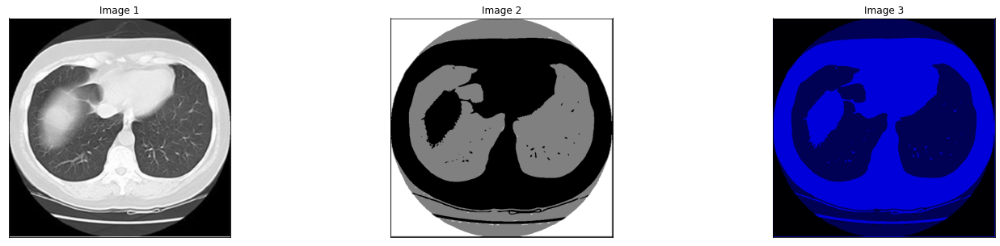

In [94]:
image_index, image_kmeans = SegmentByKmeans(image_hsv, nClusters = 3)
showListImages([image_orig, image_index, image_kmeans], rows = 1, cols = 3)

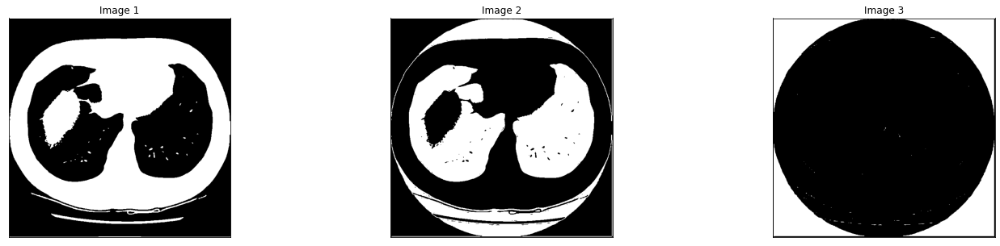

In [95]:
mask_list = []
mask_abnormal = image_gray * 0

for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 50000, maxArea = 65000)
    mask_list.append(imask)
    mask_abnormal = mask_abnormal + mask_small

showListImages(mask_list, rows = 1, cols = len(mask_list))

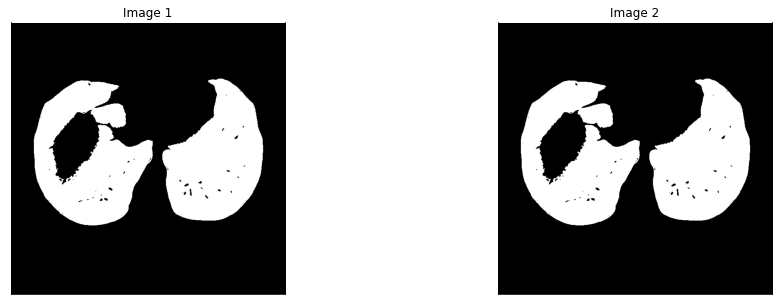

In [96]:
showListImages([mask_abnormal] * 2, rows = 1, cols = 2)

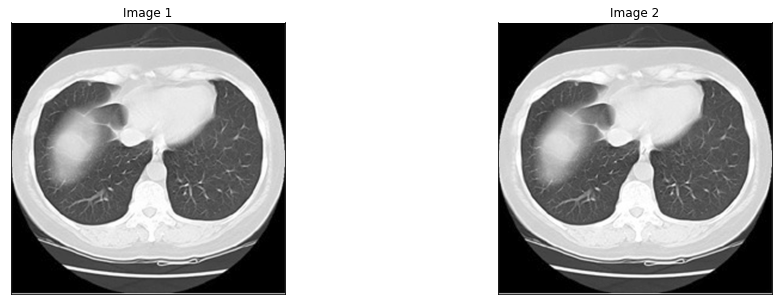

In [97]:
label_img = skimageLabel(mask_abnormal)
regions = regionprops(label_img, intensity_image = image_hsv[:, :, 0])
mask_left = mask_abnormal * 0
mask_right = mask_abnormal * 0

for props in regions:
    area = props.area
    ilabel = props.label
    imask = label_img == ilabel
    
    condition = (area < 60000)
    
    if condition:
        mask_right += imask.astype(int)
    else:
        mask_left += imask.astype(int)

showListImages([image_orig, image_gray], rows = 1, cols = 2)

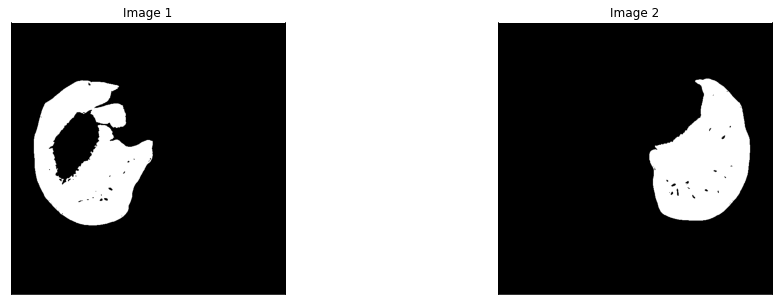

In [98]:
showListImages([mask_left, mask_right], rows = 1, cols = 2)

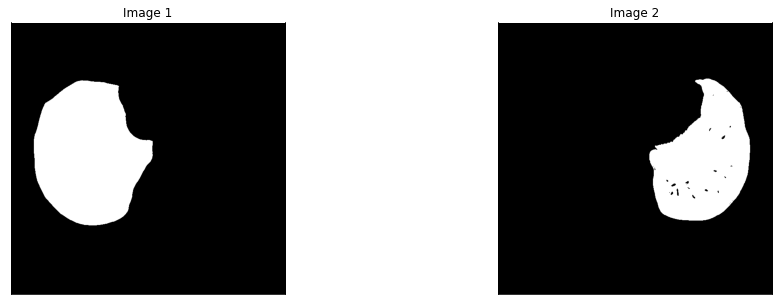

In [99]:
# Remove holes
mask_left = morphology(morphology(mask_left, 50), -50)

showListImages([mask_left, mask_right], rows = 1, cols = 2)

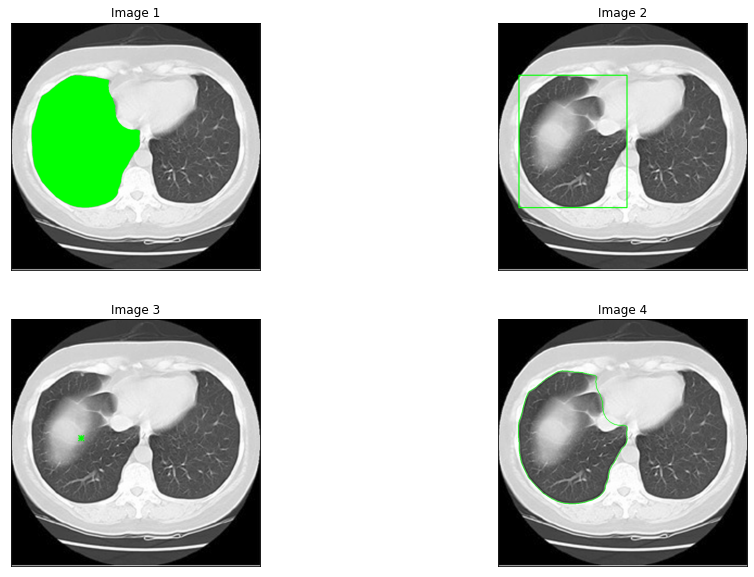

In [100]:
outputList = showOutput(image_orig, mask_left)
showListImages(outputList[1:], rows = 2, cols = 2)

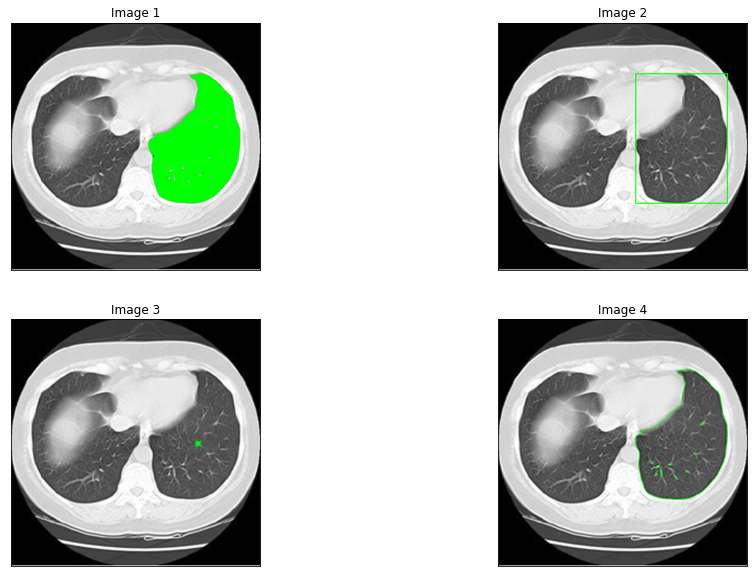

In [101]:
outputList = showOutput(image_orig, mask_right)
showListImages(outputList[1:], rows = 2, cols = 2)

# * Vết melanoma trên da

In [102]:
skin = imageDict['Skin 01.jpg']

image_orig = cv2.cvtColor(skin, cv2.COLOR_BGR2RGB)
image_gray = cv2.cvtColor(skin, cv2.COLOR_BGR2GRAY)
image_hsv = cv2.cvtColor(skin, cv2.COLOR_BGR2HSV)
image_ycbr = cv2.cvtColor(skin, cv2.COLOR_BGR2YCR_CB)

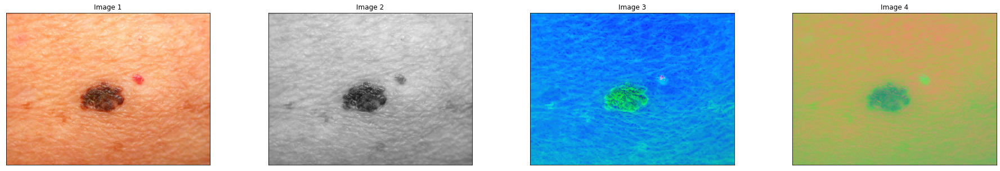

In [103]:
showListImages([image_orig, image_gray, image_hsv, image_ycbr], rows = 1, cols = 4)

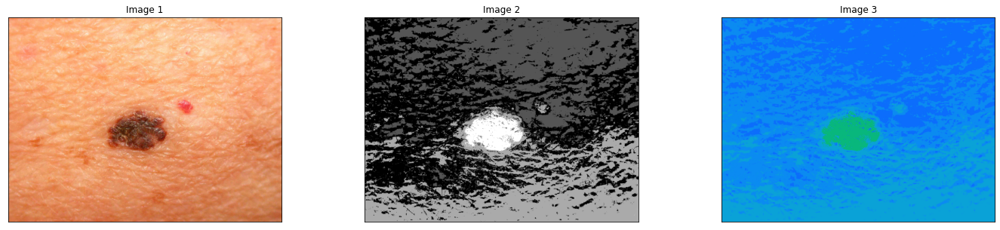

In [104]:
image_index, image_kmeans = SegmentByKmeans(image_hsv, nClusters = 4)
showListImages([image_orig, image_index, image_kmeans], rows = 1, cols = 3)

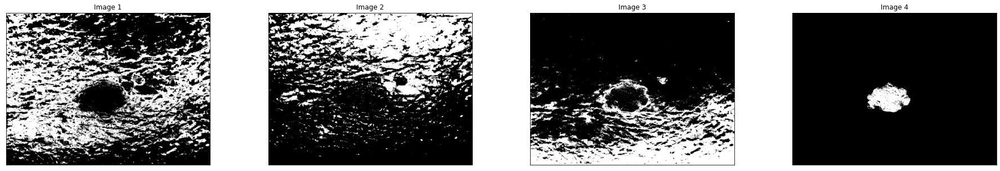

In [105]:
mask_list = []
mask_abnormal = image_gray * 0

for idx in range(image_index.max() + 1):
    imask = image_index == idx
    mask_small = SelectMaskByThreshArea(imask, minArea = 2900, maxArea = 75000)
    mask_list.append(imask)
    mask_abnormal = mask_abnormal + mask_small

showListImages(mask_list, rows = 1, cols = len(mask_list))

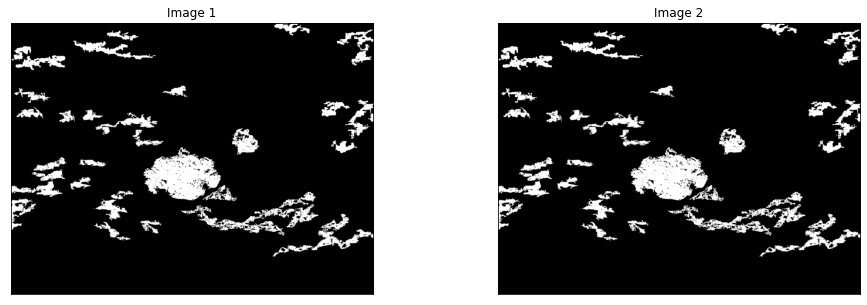

In [106]:
showListImages([mask_abnormal] * 2, rows = 1, cols = 2)

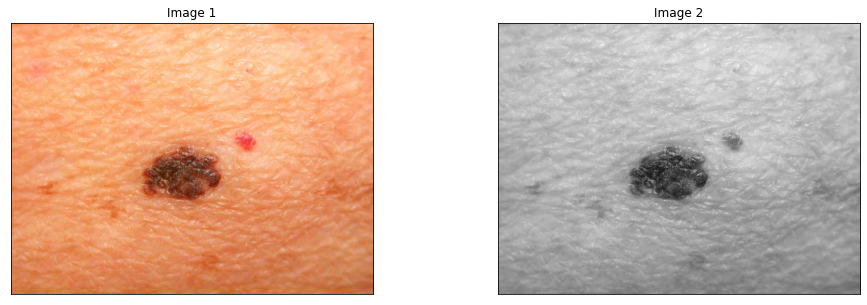

In [107]:
label_img = skimageLabel(mask_abnormal)
regions = regionprops(label_img, intensity_image = image_hsv[:, :, 0])
mask_condition = mask_abnormal * 0

for props in regions:
    area = props.area
    imean = props.mean_intensity
    imin = props.min_intensity
    imax = props.max_intensity
    label = props.label
    imask = label_img == label
    
    
    condition1 = (area > 11000) and (area < 12000)
    condition2 = (area > 74000)
    
    if condition1 or condition2:
        mask_condition += imask.astype(int)

showListImages([image_orig, image_gray], rows = 1, cols = 2)

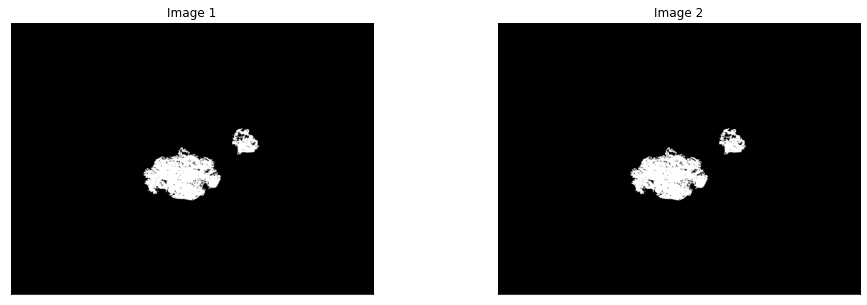

In [108]:
showListImages([mask_condition] * 2, rows = 1, cols = 2)

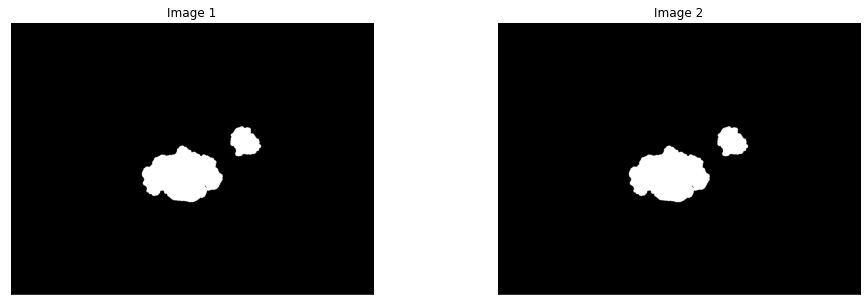

In [109]:
mask_condition = morphology(mask_condition, 10)
showListImages([mask_condition] * 2, rows = 1, cols = 2)

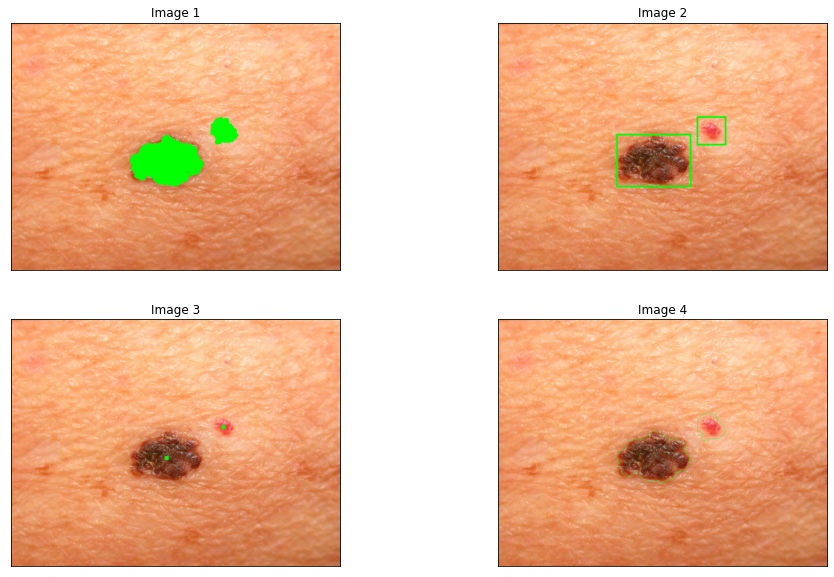

In [110]:
outputList = showOutput(image_orig, mask_condition, thick = 10)
showListImages(outputList[1:], rows = 2, cols = 2)